In [2]:
import numpy as np
import pandas as pd
import re
import os 
import glob
import matplotlib.pyplot as plt
import xlrd

C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be s

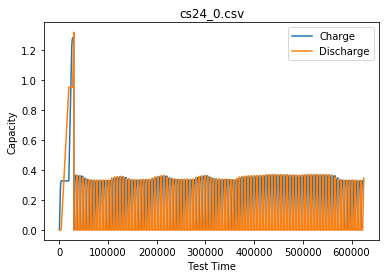

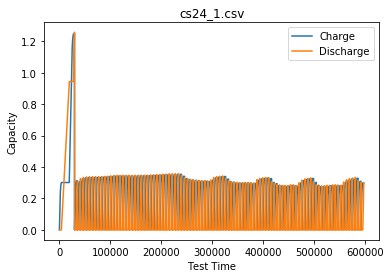

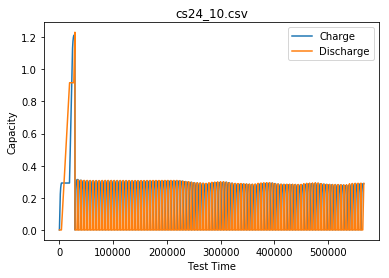

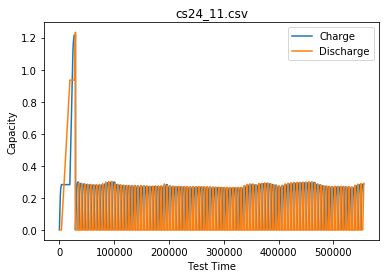

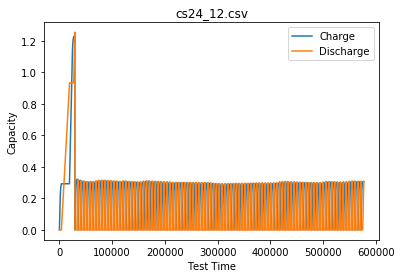

...

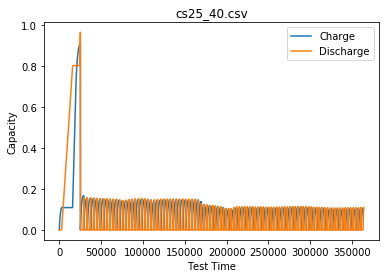

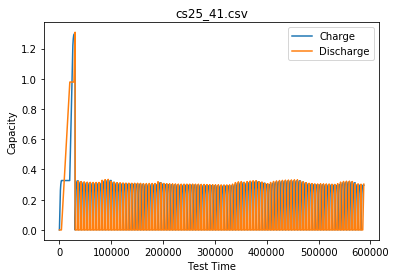

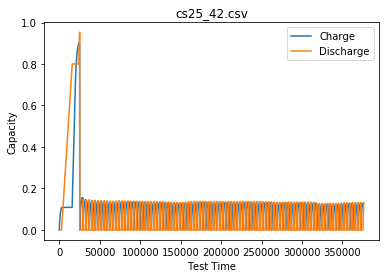

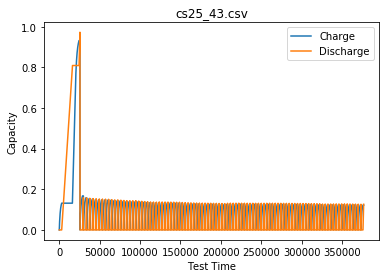

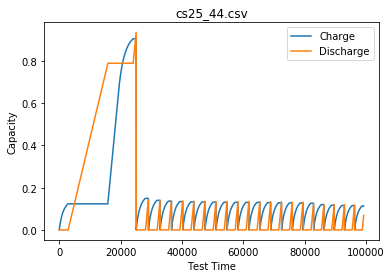

C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


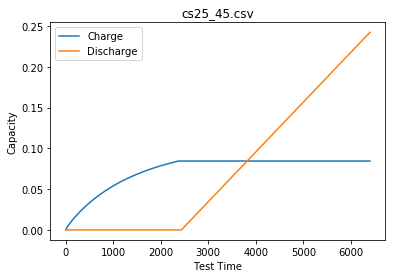

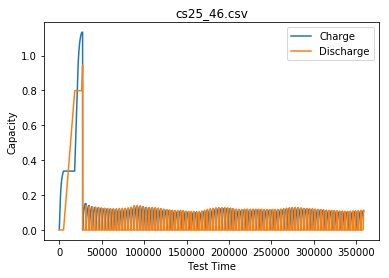

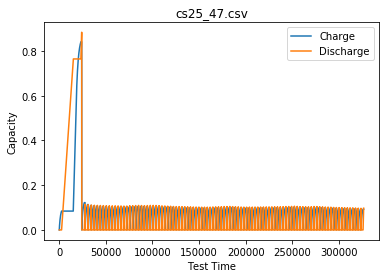

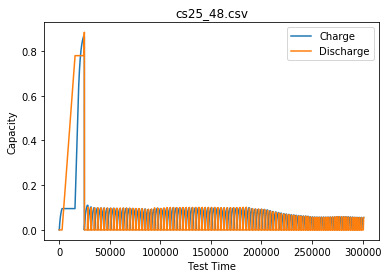

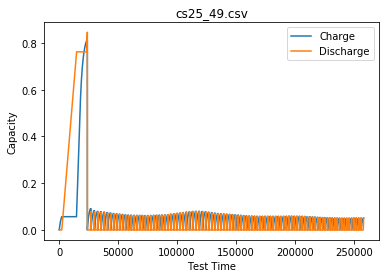

...

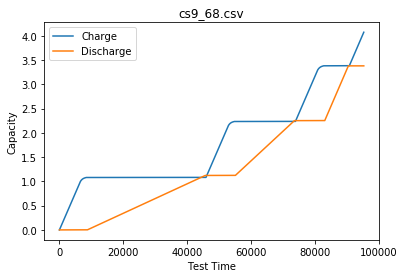

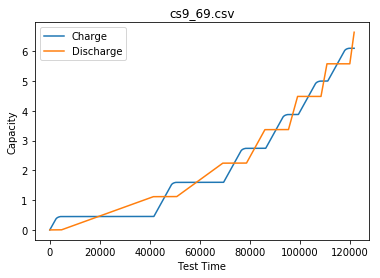

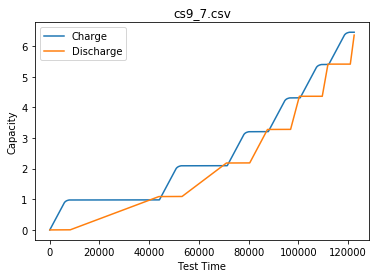

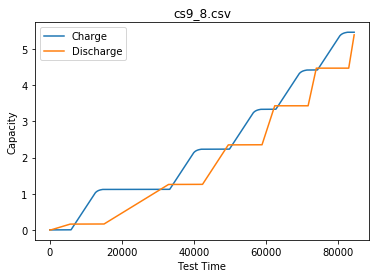

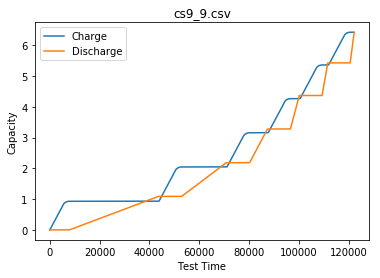

In [4]:
path = 'c:/Users/Lisboa/011019/the old BattDeg/All Data/'
files = os.listdir(path)
data_csv = list(filter(lambda x: x[-4:]=='.csv' , files))
for j in range(len(data_csv[:10])):
    filename=data_csv[j]
    test=pd.read_csv(filename)
    test['Index']=pd.Series(np.linspace(1,len(test),len(test)),index=test.index)
    group = test.groupby(['Cycle_Index']).count()
    group['Cumu_count'] = pd.Series(np.random.randn(len(group)), index=group.index)
    group['Cumu_count'] = group['Index'].cumsum()
    test['Charge'] = pd.Series(np.random.randn(len(test)), index=test.index)
    test['Discharge'] = pd.Series(np.random.randn(len(test)), index=test.index)
    cycle = []
    cycle = group['Cumu_count']
    if len(cycle)>1:
        test['Charge'][0:cycle[1]] = test['Charge_Capacity(Ah)'][0:cycle[1]]
        test['Discharge'][0:cycle[1]] = test['Discharge_Capacity(Ah)'][0:cycle[1]]
        for i in range(1,len(cycle)):
            test['Charge'][cycle[i]:cycle[i+1]] = test['Charge_Capacity(Ah)'][cycle[i]:cycle[i+1]]-test['Charge_Capacity(Ah)'][cycle[i]]
            test['Discharge'][cycle[i]:cycle[i+1]] = test['Discharge_Capacity(Ah)'][cycle[i]:cycle[i+1]]-test['Discharge_Capacity(Ah)'][cycle[i]]
        plt.plot(test['Test_Time(s)'],test['Charge'],label='Charge')
        plt.plot(test['Test_Time(s)'],test['Discharge'],label='Discharge')
    #     plt.savefig("%d.jpg"%j)
        plt.xlabel('Test Time')
        plt.ylabel('Capacity')
        plt.title(filename)
        plt.legend()
        plt.show()
    else:
        test['Charge'][0:cycle[1]] = test['Charge_Capacity(Ah)'][0:cycle[1]]
        test['Discharge'][0:cycle[1]] = test['Discharge_Capacity(Ah)'][0:cycle[1]]
        plt.plot(test['Test_Time(s)'],test['Charge'],label='Charge')
        plt.plot(test['Test_Time(s)'],test['Discharge'],label='Discharge')
    #     plt.savefig("%d.jpg"%j)
        plt.xlabel('Test Time')
        plt.ylabel('Capacity')
        plt.title(filename)
        plt.legend()
        plt.show()

C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Lisboa\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from

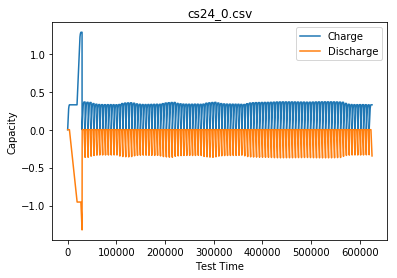

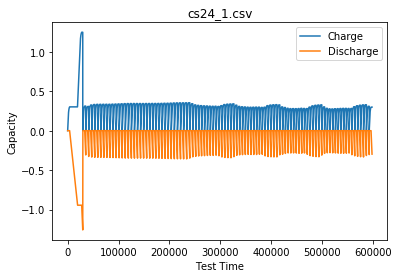

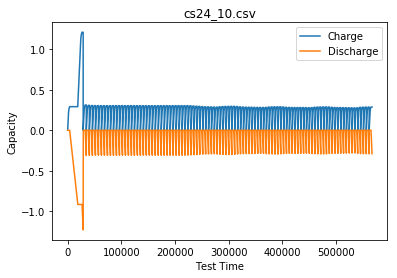

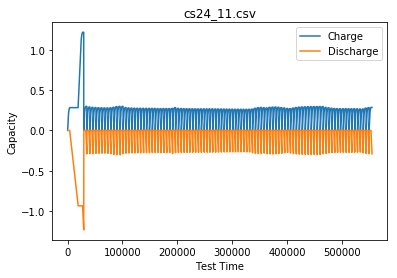

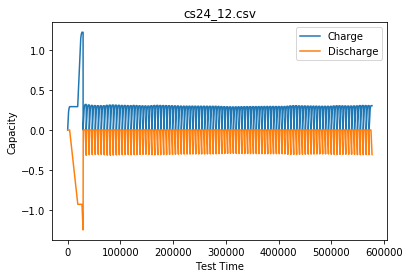

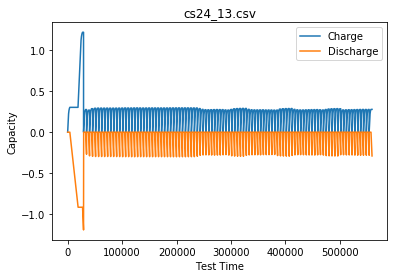

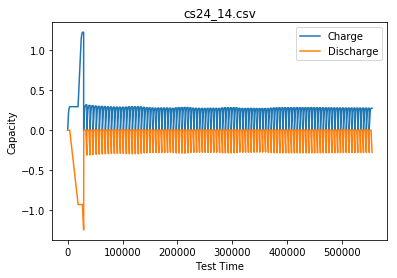

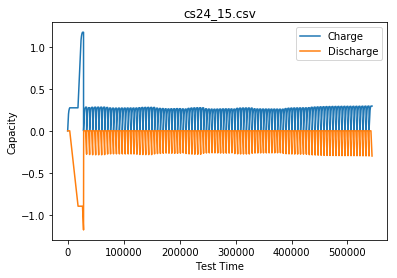

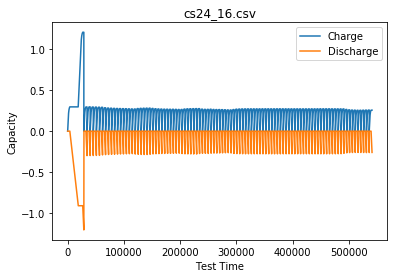

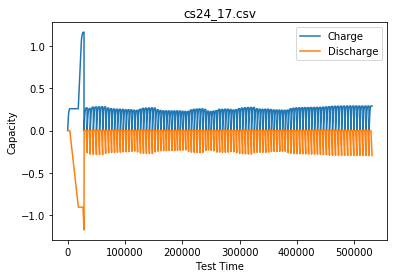

In [4]:
path = 'c:/Users/Lisboa/011019/the old BattDeg/All Data/'
files = os.listdir(path)
data_csv = list(filter(lambda x: x[-4:]=='.csv' , files))
for j in range(len(data_csv[:10])):
    filename=data_csv[j]
    test=pd.read_csv(filename)
    test['Index']=pd.Series(np.linspace(1,len(test),len(test)),index=test.index)
    group = test.groupby(['Cycle_Index']).count()
    group['Cumu_count'] = pd.Series(np.random.randn(len(group)), index=group.index)
    group['Cumu_count'] = group['Index'].cumsum()
    test['Charge'] = pd.Series(np.random.randn(len(test)), index=test.index)
    test['Discharge'] = pd.Series(np.random.randn(len(test)), index=test.index)
    test['Discharge_raw'] = pd.Series(np.random.randn(len(test)), index=test.index)
    cycle = []
    cycle = group['Cumu_count']
    if len(cycle)>1:
        test['Charge'][0:cycle[1]] = test['Charge_Capacity(Ah)'][0:cycle[1]]
        test['Discharge'][0:cycle[1]] = test['Discharge_Capacity(Ah)'][0:cycle[1]]*(-1)
        for i in range(1,len(cycle)):
            test['Charge'][cycle[i]:cycle[i+1]] = test['Charge_Capacity(Ah)'][cycle[i]:cycle[i+1]]-test['Charge_Capacity(Ah)'][cycle[i]]
            test['Discharge'][cycle[i]:cycle[i+1]] = test['Discharge_Capacity(Ah)'][cycle[i]:cycle[i+1]]*(-1)-test['Discharge_Capacity(Ah)'][cycle[i]]*(-1)
        plt.plot(test['Test_Time(s)'],test['Charge'],label='Charge')
        plt.plot(test['Test_Time(s)'],test['Discharge'],label='Discharge')
    #     plt.savefig("%d.jpg"%j)
        plt.xlabel('Test Time')
        plt.ylabel('Capacity')
        plt.title(filename)
        plt.legend()
        plt.show()
    else:
        test['Charge'][0:cycle[1]] = test['Charge_Capacity(Ah)'][0:cycle[1]]
        test['Discharge'][0:cycle[1]] = test['Discharge_Capacity(Ah)'][0:cycle[1]]
        plt.plot(test['Test_Time(s)'],test['Charge'],label='Charge')
        plt.plot(test['Test_Time(s)'],test['Discharge'],label='Discharge')
    #     plt.savefig("%d.jpg"%j)
        plt.xlabel('Test Time')
        plt.ylabel('Capacity')
        plt.title(filename)
        plt.legend()
        plt.show()